In [1]:
#!/usr/bin/env python3
import qiskit
from qiskit import (
    QuantumCircuit,
    QuantumRegister,
    ClassicalRegister,
    transpile
)
from qiskit.quantum_info import (
    Kraus, 
    SuperOp,
)
from qiskit_aer.noise import(
    depolarizing_error,
    phase_damping_error,
    NoiseModel,
    QuantumError,
    amplitude_damping_error,
)
# from qiskit_ibm_provider import IBMProvider
from qiskit import Aer
from qiskit_aer import AerSimulator
import matplotlib.pyplot as plt
from copy import deepcopy
import numpy as np
import math
import sys
sys.path.append('../')
import utilities as utl
import importlib
import json
importlib.reload(utl)
# BASIS=["h", "x", "rz", "ccx", "cx", "cz", "id"]

SHOTS=100000

def _graph_pcsZ(qc, qreg):
    print(qreg.size)
    qc.h(0)
    for idx in list(range(10,14)):
        qc.h(qreg[idx])
    qc.cx(qreg[13],qreg[9])
    # qc.cx(qreg[12],qreg[5])
    qc.cx(qreg[12],qreg[8])
    # qc.cx(qreg[10],qreg[4])
    qc.cx(qreg[11],qreg[7])
    # qc.cx(qreg[8],qreg[3])
    qc.cx(qreg[10],qreg[6])
    for idx in list(range(6,10)):
        qc.h(qreg[idx])
    # root left pcs
    qc.cx(qreg[0],qreg[1])
    qc.cx(qreg[9],qreg[5])
    # qc.cx(qreg[12],qreg[5])
    qc.cx(qreg[8],qreg[4])
    # qc.cx(qreg[10],qreg[4])
    qc.cx(qreg[7],qreg[3])
    # qc.cx(qreg[8],qreg[3])
    qc.cx(qreg[6],qreg[2])
    # qc.cx(qreg[6],qreg[2])
    for idx in list(range(2,6)):
        qc.h(qreg[idx])
    qc.cz(qreg[5],qreg[1])
    qc.cx(qreg[4],qreg[1])
    qc.cz(qreg[3],qreg[0])
    qc.cx(qreg[2],qreg[0])
    qc.barrier()
    qc.id(qreg)
    qc.barrier()
    qc.cx(qreg[2],qreg[0])
    qc.cz(qreg[3],qreg[0])
    qc.cx(qreg[4],qreg[1])
    qc.cz(qreg[5],qreg[1])
    for idx in list(range(2, 6)):
        qc.h(qreg[idx])
    # qc.cx(qreg[6],qreg[2])
    qc.cx(qreg[6],qreg[2])
    # qc.cx(qreg[8],qreg[3])
    qc.cx(qreg[7],qreg[3])
    # qc.cx(qreg[10],qreg[4])
    qc.cx(qreg[8],qreg[4])
    # qc.cx(qreg[12],qreg[5])
    qc.cx(qreg[9],qreg[5])
    qc.barrier() 
    for idx in list(range(6, 10)):
        qc.h(qreg[idx])

    qc.cx(qreg[10],qreg[6])
    qc.cx(qreg[11],qreg[7])
    qc.cx(qreg[12],qreg[8])
    qc.cx(qreg[13],qreg[9])
    for idx in list(range(10,14)):
        qc.h(qreg[idx])

    return qc 

In [2]:
tot_pcs_ancillas=12
a_qreg=QuantumRegister(14, "a")
pcs_creg=ClassicalRegister(12,"pcs")
bsm_creg=ClassicalRegister(2, "bsm")
epr_creg=ClassicalRegister(2, "epr")
junk_creg=ClassicalRegister(8, "junk") #for removing and connecting nodes
qc=QuantumCircuit(a_qreg, epr_creg, bsm_creg, pcs_creg, junk_creg)
qc=_graph_pcsZ(qc, a_qreg)

# PCS measurements.
qc.barrier()
qc.measure(a_qreg[2], pcs_creg[0])
qc.measure(a_qreg[3], pcs_creg[1])
qc.measure(a_qreg[4], pcs_creg[2])
qc.measure(a_qreg[5], pcs_creg[3])
qc.measure(a_qreg[6], pcs_creg[4])
qc.measure(a_qreg[7], pcs_creg[5])
qc.measure(a_qreg[8], pcs_creg[6])
qc.measure(a_qreg[9], pcs_creg[7])
qc.measure(a_qreg[10], pcs_creg[8])
qc.measure(a_qreg[11], pcs_creg[9])
qc.measure(a_qreg[12], pcs_creg[10])
qc.measure(a_qreg[13], pcs_creg[11])
# Convert 2 qubit graph states to bell States. These cancel with h gate from the X-basis graph measeurements.
# qc.h(a_qreg[0])
# qc.h(b_qreg[0])

qc.barrier()
qc.draw(fold=-1)

14


┌───┐                                                             ┌───┐ ░ ┌───┐ ░ ┌───┐                                       ░                                ░                                      ░ 
   a_0: ┤ H ├──■───────────────────────────────────────────────────■──────┤ X ├─░─┤ I ├─░─┤ X ├───────■───────────────────────────────░────────────────────────────────░──────────────────────────────────────░─
        └───┘┌─┴─┐                                                 │ ┌───┐└─┬─┘ ░ ├───┤ ░ └─┬─┘┌───┐  │                               ░                                ░                                      ░ 
   a_1: ─────┤ X ├──────────────────────────────────────────────■──┼─┤ X ├──┼───░─┤ I ├─░───┼──┤ X ├──┼───■───────────────────────────░────────────────────────────────░──────────────────────────────────────░─
             └───┘                                   ┌───┐┌───┐ │  │ └─┬─┘  │   ░ ├───┤ ░   │  └─┬─┘  │   │ ┌───┐┌───┐                ░                                ░ ┌─┐                                  ░ 
   a_2: ─────────────────────────────────────────────┤ X ├┤ H ├─┼──┼───┼────■───░─┤ I ├─░───■────┼────┼───┼─┤ H ├┤ X ├────────────────░────────────────────────────────░─┤M├──────────────────────────────────░─
                                                ┌───┐└─┬─┘├───┤ │  │   │        ░ ├───┤ ░        │    │   │ ├───┤└─┬─┘     ┌───┐      ░                                ░ └╥┘┌─┐                               ░ 
   a_3: ────────────────────────────────────────┤ X ├──┼──┤ H ├─┼──■───┼────────░─┤ I ├─░────────┼────■───┼─┤ H ├──┼───────┤ X ├──────░────────────────────────────────░──╫─┤M├───────────────────────────────░─
                                           ┌───┐└─┬─┘  │  ├───┤ │      │        ░ ├───┤ ░        │  ┌───┐ │ └───┘  │  ┌───┐└─┬─┘      ░                                ░  ║ └╥┘┌─┐                            ░ 
   a_4: ───────────────────────────────────┤ X ├──┼────┼──┤ H ├─┼──────■────────░─┤ I ├─░────────■──┤ H ├─┼────────┼──┤ X ├──┼────────░────────────────────────────────░──╫──╫─┤M├────────────────────────────░─
                                      ┌───┐└─┬─┘  │    │  ├───┤ │               ░ ├───┤ ░           └───┘ │ ┌───┐  │  └─┬─┘  │  ┌───┐ ░                                ░  ║  ║ └╥┘┌─┐                         ░ 
   a_5: ──────────────────────────────┤ X ├──┼────┼────┼──┤ H ├─■───────────────░─┤ I ├─░─────────────────■─┤ H ├──┼────┼────┼──┤ X ├─░────────────────────────────────░──╫──╫──╫─┤M├─────────────────────────░─
                            ┌───┐┌───┐└─┬─┘  │    │    │  └───┘                 ░ ├───┤ ░                   └───┘  │    │    │  └─┬─┘ ░ ┌───┐┌───┐                     ░  ║  ║  ║ └╥┘┌─┐                      ░ 
   a_6: ────────────────────┤ X ├┤ H ├──┼────┼────┼────■────────────────────────░─┤ I ├─░──────────────────────────■────┼────┼────┼───░─┤ H ├┤ X ├─────────────────────░──╫──╫──╫──╫─┤M├──────────────────────░─
                       ┌───┐└─┬─┘├───┤  │    │    │                             ░ ├───┤ ░                               │    │    │   ░ ├───┤└─┬─┘┌───┐                ░  ║  ║  ║  ║ └╥┘┌─┐                   ░ 
   a_7: ───────────────┤ X ├──┼──┤ H ├──┼────┼────■─────────────────────────────░─┤ I ├─░───────────────────────────────┼────■────┼───░─┤ H ├──┼──┤ X ├────────────────░──╫──╫──╫──╫──╫─┤M├───────────────────░─
                  ┌───┐└─┬─┘  │  ├───┤  │    │                                  ░ ├───┤ ░                               │         │   ░ ├───┤  │  └─┬─┘┌───┐           ░  ║  ║  ║  ║  ║ └╥┘┌─┐                ░ 
   a_8: ──────────┤ X ├──┼────┼──┤ H ├──┼────■──────────────────────────────────░─┤ I ├─░───────────────────────────────■─────────┼───░─┤ H ├──┼────┼──┤ X ├───────────░──╫──╫──╫──╫──╫──╫─┤M├────────────────░─
             ┌───┐└─┬─┘  │    │  ├───┤  │                                       ░ ├───┤ ░                                         │   ░ ├───┤  │    │  └─┬─┘┌───┐      ░  ║  ║  ║  ║  ║  ║ └╥┘┌─┐             ░ 
   a_9: ─────┤ X ├──┼────┼────┼──┤ H 

In [3]:
pcs_all_fidelities=[]
pcs_post_select_rates=[]
errors=np.linspace(0.0, stop=0.5, num=11, endpoint=True)
error_gate1=0.001
# error_gate1=0
# errors=[0]
for error in errors:
        noise_model=utl.get_noise_model(error_gate1)
        print(f"depolarizing error: {error}")
        depol1=depolarizing_error(error, 1)
        noise_model.add_all_qubit_quantum_error(depol1, ["id"])
        print(noise_model)

        backend=AerSimulator(noise_model=noise_model)
        pcs_ancillas_pos=1 # the position of the classical registers that contain the pcs measurements.
        result_xx=utl.meas_xx(qc, [a_qreg[0], a_qreg[1]], epr_creg, backend, SHOTS)
        result_yy=utl.meas_yy(qc, [a_qreg[0], a_qreg[1]], epr_creg, backend, SHOTS)
        result_zz=utl.meas_zz(qc, [a_qreg[0], a_qreg[1]], epr_creg, backend, SHOTS)

        xx_counts=utl.post_select(result_xx.get_counts(), tot_pcs_ancillas, pcs_ancillas_pos)
        yy_counts=utl.post_select(result_yy.get_counts(), tot_pcs_ancillas, pcs_ancillas_pos)
        zz_counts=utl.post_select(result_zz.get_counts(), tot_pcs_ancillas, pcs_ancillas_pos)
        pcs_post_select_rates.append(min([sum(xx_counts.values()),sum(yy_counts.values()),sum(zz_counts.values())])/SHOTS)
        epr_idx=-1 #the position of the classical registers that contain measurements of the 
                #epr pair.
        expect_xx=utl.expect_of_vals(utl.to_percent(utl.collect_meas(xx_counts, epr_idx)))
        expect_yy=utl.expect_of_vals(utl.to_percent(utl.collect_meas(yy_counts, epr_idx)))
        expect_zz=utl.expect_of_vals(utl.to_percent(utl.collect_meas(zz_counts, epr_idx)))
        pcs_fidelity=utl.fidelity_phip(expect_xx, expect_yy, expect_zz)
        print(pcs_fidelity)
        pcs_all_fidelities.append(pcs_fidelity)

depolarizing error: 0.0
NoiseModel:
  Basis gates: ['ccx', 'cx', 'cz', 'h', 'id', 'rz', 'sx', 'x', 'y', 'z']
  Instructions with noise: ['measure', 'y', 'x', 'ccx', 'rz', 'h', 'cz', 'cx', 'z']
  All-qubits errors: ['cx', 'cz', 'ccx', 'h', 'x', 'y', 'z', 'rz', 'measure']
xx circ: 
        ┌───┐                                                             ┌───┐»
   a_0: ┤ H ├──■───────────────────────────────────────────────────■──────┤ X ├»
        └───┘┌─┴─┐                                                 │ ┌───┐└─┬─┘»
   a_1: ─────┤ X ├──────────────────────────────────────────────■──┼─┤ X ├──┼──»
             └───┘                                   ┌───┐┌───┐ │  │ └─┬─┘  │  »
   a_2: ─────────────────────────────────────────────┤ X ├┤ H ├─┼──┼───┼────■──»
                                                ┌───┐└─┬─┘├───┤ │  │   │       »
   a_3: ────────────────────────────────────────┤ X ├──┼──┤ H ├─┼──■───┼───────»
                                           ┌───┐└─┬─┘  │  ├───┤ │      

[0.979793963684672, 0.9766713536731391, 0.9709328136251701, 0.9571176539511423, 0.9406856709194088, 0.917745237362447, 0.8709485920655905, 0.8216013540733123, 0.7605130658902216, 0.6849915960916401, 0.577408377860531]
[0.80664, 0.47302, 0.27521, 0.15652, 0.08856, 0.04947, 0.02736, 0.01449, 0.00831, 0.0044, 0.0026]
[0.   0.05 0.1  0.15 0.2  0.25 0.3  0.35 0.4  0.45 0.5 ]


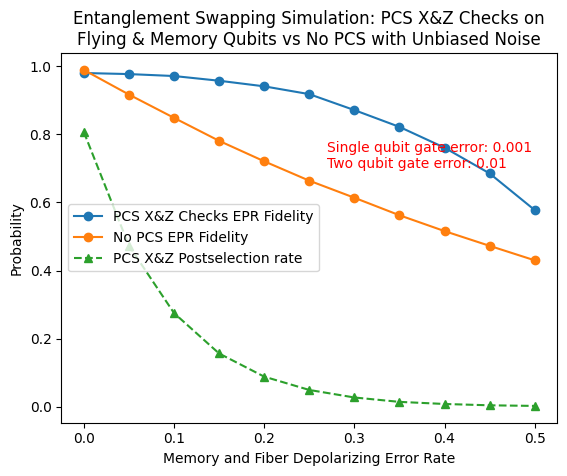

[0.979793963684672, 0.9766713536731391, 0.9709328136251701, 0.9571176539511423, 0.9406856709194088, 0.917745237362447, 0.8709485920655905, 0.8216013540733123, 0.7605130658902216, 0.6849915960916401, 0.577408377860531]
[0.9888499999999999, 0.9166, 0.8482000000000001, 0.7807, 0.72065, 0.66375, 0.61365, 0.56225, 0.5157499999999999, 0.47245000000000004, 0.42995]
[0.80664, 0.47302, 0.27521, 0.15652, 0.08856, 0.04947, 0.02736, 0.01449, 0.00831, 0.0044, 0.0026]
[0.   0.05 0.1  0.15 0.2  0.25 0.3  0.35 0.4  0.45 0.5 ]


In [5]:
print(pcs_all_fidelities)
print(pcs_post_select_rates)
print(errors)
reps=2
with open(f"json\\pcsXZ_rec2_xonlylater_unbiased_noswap.json", "w") as fxz:
        json.dump({"errors": errors.tolist(), "fidelities": pcs_all_fidelities, "postselectRates": pcs_post_select_rates}, fxz)
with open("json\\raw_unbiased_noswap.json") as fRaw:
        dataRaw=json.load(fRaw)
nopcs_all_fidelities=dataRaw["fidelities"]
plt.plot(errors, pcs_all_fidelities, label="PCS X&Z Checks EPR Fidelity", marker='o')
plt.plot(errors, nopcs_all_fidelities, label="No PCS EPR Fidelity", marker='o')
plt.plot(errors, pcs_post_select_rates, label="PCS X&Z Postselection rate",  marker='^', linestyle="--")
plt.ylabel('Probability')
plt.xlabel(f"Memory and Fiber Depolarizing Error Rate")
plt.text(0.27, .7, f"Single qubit gate error: {error_gate1}\nTwo qubit gate error: {round(error_gate1*10, 4)}", color = "red")
plt.title(f"Entanglement Swapping Simulation: PCS X&Z Checks on\nFlying & Memory Qubits vs No PCS with Unbiased Noise")
plt.legend()
plt.savefig(f"images\\pcsXZ_rec2_zonlylater_unbiased_noswap.png")
plt.show()
print(pcs_all_fidelities)
print(nopcs_all_fidelities)
print(pcs_post_select_rates)
print(errors)